In [1]:
import pandas as pd
import numpy as np

# set the seed
np.random.seed(99)

In [2]:
# Load and preprocess data
day_ahead = pd.read_csv('../data/Day Ahead Auction Prices.csv')
day_ahead['datetime'] = pd.to_datetime(day_ahead['Date'])
day_ahead.rename(columns={'Day Ahead Auction Price EUR/MWh': 'price'}, inplace=True)
day_ahead = day_ahead[['datetime', 'price']]
day_ahead.set_index('datetime', inplace=True)
# Set hourly frequency for the index to ensure consistent time series data
day_ahead = day_ahead.asfreq('h')

In [3]:
# Split the data into training and testing sets
y_train = day_ahead.loc[:'2023-04-30']
y_test = day_ahead.loc['2023-05-01':]

print("Training data:")
print(y_train.head())
print(y_train.tail())

print("\nTesting data:")
print(y_test.head())
print(y_test.tail())

Training data:
                     price
datetime                  
2016-01-01 00:00:00  23.86
2016-01-01 01:00:00  22.39
2016-01-01 02:00:00  20.59
2016-01-01 03:00:00  16.81
2016-01-01 04:00:00  17.41
                      price
datetime                   
2023-04-30 19:00:00  121.16
2023-04-30 20:00:00  123.60
2023-04-30 21:00:00  122.20
2023-04-30 22:00:00  117.12
2023-04-30 23:00:00  108.71

Testing data:
                      price
datetime                   
2023-05-01 00:00:00  109.90
2023-05-01 01:00:00   99.90
2023-05-01 02:00:00   95.49
2023-05-01 03:00:00   89.98
2023-05-01 04:00:00   87.29
                      price
datetime                   
2024-05-31 19:00:00  107.94
2024-05-31 20:00:00  115.00
2024-05-31 21:00:00  107.91
2024-05-31 22:00:00  101.74
2024-05-31 23:00:00   84.18


In [4]:
from sktime.forecasting.model_selection import ForecastingGridSearchCV, SlidingWindowSplitter
from sktime.performance_metrics.forecasting import MeanSquaredError
from sktime.forecasting.base import ForecastingHorizon
from sktime.forecasting.compose import ForecastingPipeline
from sktime.forecasting.fbprophet import Prophet

# Define forecasting horizon (1 year ahead in hourly steps)
fh = ForecastingHorizon([i for i in range(1, 8761)], is_relative=True)

# Set up cross-validation split for time series using a moving window splitter
cv = SlidingWindowSplitter(fh=[24*365], window_length=24*365, step_length=24*365)

# Set up parameter grid with different strategies
param_grid = {
    'forecaster__seasonality_mode': ['additive', 'multiplicative'],
    'forecaster__yearly_seasonality': [True],
    'forecaster__weekly_seasonality': [True],
    'forecaster__daily_seasonality': [True],
    'forecaster__seasonality_prior_scale': [0.01, 0.1, 1.0, 10.0],
    'forecaster__changepoint_prior_scale': [0.01, 0.1, 0.5, 1.0],
    'forecaster__holidays_prior_scale': [0.01, 0.1, 1.0, 10.0]
}

pipeline = ForecastingPipeline(
    steps=[
        ("forecaster", Prophet(add_country_holidays={"country_name": "Germany"})),
    ]
)

# Create a ForecastingGridSearchCV with MAE as the scoring metric
gscv = ForecastingGridSearchCV(
    forecaster=pipeline,
    param_grid=param_grid,
    cv=cv,
    scoring=MeanSquaredError(), # MAE or MAPE can also be used
    verbose=5,
    error_score='raise',
    n_jobs=-1
)

# Fit the model with GridSearchCV
gscv.fit(y_train[['price']], fh=fh)

# Get the best parameters
best_params = gscv.best_params_
best_model = gscv.best_forecaster_

# Print the best model and parameters
print("Best model:", best_model)
print("Best parameters:", best_params)

/Users/adrianscholl/LRZ Sync+Share/Projects/price-forward-curve/.venv/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Fitting 6 folds for each of 128 candidates, totalling 768 fits


/Users/adrianscholl/LRZ Sync+Share/Projects/price-forward-curve/.venv/lib/python3.9/site-packages/sktime/forecasting/model_selection/_tune.py:90: UserWarning: Parameter n_jobs of ForecastingGridSearchCV has been removed in sktime 0.27.0 and is no longer used. It is ignored when passed. Instead, the backend and backend_params parameters should be used to pass n_jobs or other parallelization parameters.
  warn(
/Users/adrianscholl/LRZ Sync+Share/Projects/price-forward-curve/.venv/lib/python3.9/site-packages/sktime/forecasting/model_selection/_tune.py:90: UserWarning: Parameter n_jobs of ForecastingGridSearchCV has been removed in sktime 0.27.0 and is no longer used. It is ignored when passed. Instead, the backend and backend_params parameters should be used to pass n_jobs or other parallelization parameters.
  warn(
13:42:51 - cmdstanpy - INFO - Chain [1] start processing
13:43:22 - cmdstanpy - INFO - Chain [1] done processing
13:43:25 - cmdstanpy - INFO - Chain [1] start processing
13:4

Best model: ForecastingPipeline(steps=[('forecaster',
                            Prophet(add_country_holidays={'country_name': 'Germany'},
                                    changepoint_prior_scale=0.1,
                                    daily_seasonality=True,
                                    seasonality_prior_scale=0.01,
                                    weekly_seasonality=True,
                                    yearly_seasonality=True))])
Best parameters: {'forecaster__changepoint_prior_scale': 0.1, 'forecaster__daily_seasonality': True, 'forecaster__holidays_prior_scale': 10.0, 'forecaster__seasonality_mode': 'additive', 'forecaster__seasonality_prior_scale': 0.01, 'forecaster__weekly_seasonality': True, 'forecaster__yearly_seasonality': True}


In [5]:
from prophet import Prophet

type(best_model.forecaster_)
# Extract the best parameters
best_params = gscv.best_params_

# Initialize the Prophet model with the best parameters
prophet_model = Prophet(
    seasonality_mode=best_params['forecaster__seasonality_mode'],
    yearly_seasonality=best_params['forecaster__yearly_seasonality'],
    weekly_seasonality=best_params['forecaster__weekly_seasonality'],
    daily_seasonality=best_params['forecaster__daily_seasonality'],
    seasonality_prior_scale=best_params['forecaster__seasonality_prior_scale'],
    changepoint_prior_scale=best_params['forecaster__changepoint_prior_scale'],
    holidays_prior_scale=best_params['forecaster__holidays_prior_scale']
)

# Add country holidays
prophet_model.add_country_holidays(country_name='DE')

# Fit the Prophet model
prophet_model.fit(day_ahead.reset_index().rename(columns={'datetime': 'ds', 'price': 'y'}))

13:44:00 - cmdstanpy - INFO - Chain [1] start processing
13:44:26 - cmdstanpy - INFO - Chain [1] done processing


13:44:27 - cmdstanpy - INFO - Chain [1] start processing
13:44:27 - cmdstanpy - INFO - Chain [1] done processing
13:44:28 - cmdstanpy - INFO - Chain [1] start processing
13:44:29 - cmdstanpy - INFO - Chain [1] done processing
13:44:30 - cmdstanpy - INFO - Chain [1] start processing
13:44:31 - cmdstanpy - INFO - Chain [1] done processing
13:44:32 - cmdstanpy - INFO - Chain [1] start processing
13:44:32 - cmdstanpy - INFO - Chain [1] done processing
13:44:33 - cmdstanpy - INFO - Chain [1] start processing
13:44:34 - cmdstanpy - INFO - Chain [1] done processing
13:44:35 - cmdstanpy - INFO - Chain [1] start processing
13:44:37 - cmdstanpy - INFO - Chain [1] done processing


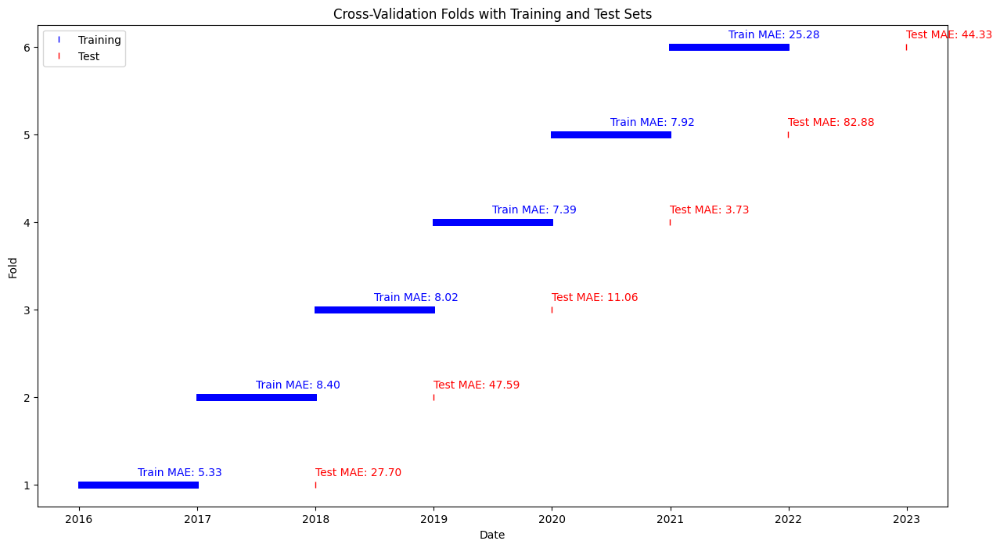

In [6]:
import matplotlib.pyplot as plt
from sktime.performance_metrics.forecasting import mean_absolute_error

# Extract the splits from the cross-validation object
splits = list(cv.split(y_train))

# Initialize the plot
fig, ax = plt.subplots(figsize=(15, 8))

# Loop through each fold
for i, (train_idx, test_idx) in enumerate(splits):
    # Get the training and test sets for the current fold
    train_dates = y_train.index[train_idx]
    test_dates = y_train.index[test_idx]
    
    # Plot the training and test sets
    ax.plot(train_dates, [i + 1] * len(train_dates), '|', color='blue', label='Training' if i == 0 else "")
    ax.plot(test_dates, [i + 1] * len(test_dates), '|', color='red', label='Test' if i == 0 else "")
    
    # Calculate MAE for the current fold
    y_train_fold = y_train.iloc[train_idx]
    y_test_fold = y_train.iloc[test_idx]
    
    best_model.fit(y_train_fold, fh=fh)
    y_train_pred_fold = best_model.predict(fh=ForecastingHorizon(y_train_fold.index, is_relative=False))
    y_test_pred_fold = best_model.predict(fh=ForecastingHorizon(y_test_fold.index, is_relative=False))
    
    mae_train_fold = mean_absolute_error(y_train_fold['price'], y_train_pred_fold['price'])
    mae_test_fold = mean_absolute_error(y_test_fold['price'], y_test_pred_fold['price'])
    
    # Add MAE scores as labels
    ax.text(train_dates[int(len(train_dates) / 2)], i + 1.1, f'Train MAE: {mae_train_fold:.2f}', fontsize=10, color='blue')
    ax.text(test_dates[int(len(test_dates) / 2)], i + 1.1, f'Test MAE: {mae_test_fold:.2f}', fontsize=10, color='red')

# Customize the plot
ax.set_xlabel('Date')
ax.set_ylabel('Fold')
ax.set_title('Cross-Validation Folds with Training and Test Sets')
ax.legend()
plt.show()

In [7]:
# Predict in-sample maximum a posteriori estimate
y_train_pred = best_model.predict(fh=ForecastingHorizon(y_train.index, is_relative=False))
y_pred  = best_model.predict(fh=ForecastingHorizon(y_test.index, is_relative=False))

# Predict in-sample intervals: 10% and 90% percentiles
y_train_pred_interval = best_model.predict_interval(coverage=0.9, fh=ForecastingHorizon(y_train.index, is_relative=False))
y_pred_interval = best_model.predict_interval(coverage=0.9, fh=ForecastingHorizon(y_test.index, is_relative=False))

y_train_pred_lower = y_train_pred_interval.loc[:, ("price", 0.9, "lower")]
y_train_pred_upper = y_train_pred_interval.loc[:, ("price", 0.9, "upper")]

y_pred_lower  = y_pred_interval.loc[:, ("price", 0.9, "lower")]
y_pred_upper  = y_pred_interval.loc[:, ("price", 0.9, "upper")]

print("In-sample prediction:")
print(y_train_pred_interval)

In-sample prediction:
                            price              
                              0.9              
                            lower         upper
2016-01-01 00:00:00 -16830.385708 -16702.648591
2016-01-01 01:00:00 -16835.671925 -16708.530994
2016-01-01 02:00:00 -16846.913620 -16716.092372
2016-01-01 03:00:00 -16846.981539 -16721.927996
2016-01-01 04:00:00 -16848.115664 -16715.914438
...                           ...           ...
2023-04-30 19:00:00  -2310.397660   2172.451358
2023-04-30 20:00:00  -2278.028601   2167.411128
2023-04-30 21:00:00  -2312.139615   2143.284723
2023-04-30 22:00:00  -2305.075977   2101.662870
2023-04-30 23:00:00  -2353.507856   2087.930088

[64248 rows x 2 columns]


In [8]:
import plotly.graph_objects as go

# Create the interactive plot
fig = go.Figure()

# Add actual values
fig.add_trace(go.Scatter(x=y_train.index, y=y_train['price'], mode='lines', name='y_train'))

# Add predicted values for training set
fig.add_trace(go.Scatter(x=y_train.index, y=y_train_pred['price'], mode='lines', name='y_hat'))

# Add forecasted values for test set
fig.add_trace(go.Scatter(x=y_test.index, y=y_pred['price'], mode='lines', name='y_pred', line=dict(color='orange')))

# Add actual values for test set
fig.add_trace(go.Scatter(x=y_test.index, y=y_test['price'], mode='lines', name='y_test', line=dict(color='lightblue')))

# Add 10% and 90% percentiles for y_train_pred as filled area
fig.add_trace(go.Scatter(
    x=pd.concat([y_train.index.to_series(), y_train.index.to_series()[::-1]]),
    y=pd.concat([y_train_pred_upper, y_train_pred_lower[::-1]]),
    fill='toself',
    fillcolor='rgba(255, 0, 0, 0.2)',
    line=dict(color='rgba(255, 0, 0, 0)'),
    showlegend=True,
    name='y_hat_interval'
))

# Add 10% and 90% percentiles for y_pred
fig.add_trace(go.Scatter(
    x=pd.concat([y_test.index.to_series(), y_test.index.to_series()[::-1]]),
    y=pd.concat([y_pred_upper, y_pred_lower[::-1]]),
    fill='toself',
    fillcolor='rgba(255, 165, 0, 0.2)',
    line=dict(color='rgba(255, 165, 0, 0)'),
    showlegend=True,
    name='y_pred_interval'
))

# Customize the layout
fig.update_layout(
    title='In-sample Fit and Forecast of the Best Grid Search Model',
    xaxis_title='Date',
    yaxis_title='Price',
    hovermode='x unified'
)

# Show the plot
fig.show()

In [9]:
# Calculate the in-sample and out-of-sample MSE and MAE
from sktime.performance_metrics.forecasting import mean_absolute_percentage_error
from sktime.performance_metrics.forecasting import mean_absolute_error
from sktime.performance_metrics.forecasting import mean_squared_error

# Calculate the in-sample and out-of-sample MSE and MAE
mse_in_sample = mean_squared_error(y_train['price'], y_train_pred['price'])
mae_in_sample = mean_absolute_error(y_train['price'], y_train_pred['price'])
mape_in_sample = mean_absolute_percentage_error(y_train['price'], y_train_pred['price'])

mse_out_sample = mean_squared_error(y_test['price'], y_pred['price'])
mae_out_sample = mean_absolute_error(y_test['price'], y_pred['price'])
mape_out_sample = mean_absolute_percentage_error(y_test['price'], y_pred['price'])

# Show the results in a bar plot
fig = go.Figure(data=[
    go.Bar(name='MSE', x=['In-sample', 'Out-of-sample'], y=[mse_in_sample, mse_out_sample]),
    go.Bar(name='MAE', x=['In-sample', 'Out-of-sample'], y=[mae_in_sample, mae_out_sample]),
    go.Bar(name='MAPE', x=['In-sample', 'Out-of-sample'], y=[mape_in_sample, mape_out_sample])
])

# Customize the layout
fig.update_layout(
    title='In-sample and Out-of-sample Forecasting Performance',
    yaxis_title='Performance',
    barmode='group'
)

# Show the plot
fig.show()

In [10]:
# Calculate residuals for in-sample and out-of-sample predictions
residuals_in_sample = y_train['price'] - y_train_pred['price']
residuals_out_sample = y_test['price'] - y_pred['price']

# Create the interactive plot
fig = go.Figure()

# Add residuals for in-sample
fig.add_trace(go.Scatter(x=y_train.index, y=residuals_in_sample, mode='lines', name='In-sample Residuals', line=dict(color='red')))

# Add residuals for out-of-sample
fig.add_trace(go.Scatter(x=y_test.index, y=residuals_out_sample, mode='lines', name='Out-of-sample Residuals', line=dict(color='orange')))

# Customize the layout
fig.update_layout(
    title='Residuals of the Best Grid Search Model',
    xaxis_title='Date',
    yaxis_title='Residuals',
    hovermode='x unified'
)

# Show the plot
fig.show()

In [11]:
best_model.forecaster_

Prophet(add_country_holidays={'country_name': 'Germany'},
        changepoint_prior_scale=0.1, daily_seasonality=True,
        seasonality_prior_scale=0.01, weekly_seasonality=True,
        yearly_seasonality=True)

In [12]:
# Extract the components from the best model
components = best_model.steps[0][1].predict_components(y_train.index)

# Create the interactive plot
fig = go.Figure()

# Add trend component
fig.add_trace(go.Scatter(x=components.index, y=components['trend'], mode='lines', name='Trend'))

# Add yearly seasonality component
fig.add_trace(go.Scatter(x=components.index, y=components['yearly'], mode='lines', name='Yearly Seasonality'))

# Add weekly seasonality component
fig.add_trace(go.Scatter(x=components.index, y=components['weekly'], mode='lines', name='Weekly Seasonality'))

# Add daily seasonality component
fig.add_trace(go.Scatter(x=components.index, y=components['daily'], mode='lines', name='Daily Seasonality'))

# Customize the layout
fig.update_layout(
    title='Trend, Seasonality, and Other Components of the Best Model',
    xaxis_title='Date',
    yaxis_title='Component Value',
    hovermode='x unified'
)

# Show the plot
fig.show()

AttributeError: 'Prophet' object has no attribute 'predict_components'

In [21]:
from fb_prophet import *

In [22]:
# File path to the CSV data
file_path = '../data/Day Ahead Auction Prices.csv'

# Load and preprocess the data
day_ahead = load_day_ahead_prices(file_path)

# Prepare the DataFrame for Prophet
df = day_ahead.reset_index().rename(columns={'datetime': 'ds', 'price': 'y'})
df

,ds,y
0,2016-01-01 00:00:00,23.86
1,2016-01-01 01:00:00,22.39
2,2016-01-01 02:00:00,20.59
3,2016-01-01 03:00:00,16.81
4,2016-01-01 04:00:00,17.41
...,...,...
73771,2024-05-31 19:00:00,107.94
73772,2024-05-31 20:00:00,115.00
73773,2024-05-31 21:00:00,107.91
73774,2024-05-31 22:00:00,101.74


In [ ]:
# Get the last date in the dataset
last_date = df['ds'].max()

# Define train-test split
train_end_date = last_date - pd.Timedelta(days=365)
train_df = df[df['ds'] <= train_end_date]
test_df = df[df['ds'] > train_end_date]

# Define the parameter grid
param_grid = {
    'seasonality_mode': ['additive', 'multiplicative'],
    'changepoint_prior_scale': [0.01, 0.1, 0.5],
    'seasonality_prior_scale': [10.0, 15.0, 20.0],
    'holidays_prior_scale': [10.0, 15.0, 20.0],
}

In [ ]:
# Perform hyperparameter tuning
horizon = '365 days'
tuning_results = tune_hyperparameters(train_df, param_grid, horizon)
tuning_results

In [ ]:
# Fit the best model
best_params = tuning_results.loc[tuning_results['rmse'].idxmin()].to_dict()
m = Prophet(**{k: v for k, v in best_params.items() if k != 'rmse'})
m.add_country_holidays(country_name='DE')
m.fit(train_df)
print("best_params", best_params)

In [ ]:
# Forecast future values
future = m.make_future_dataframe(periods=365 * 24, freq='h')  # 1-year forecast
forecast = m.predict(future)

# Evaluate model on test set
y_test = test_df['y'].values
y_pred = forecast.loc[forecast['ds'].isin(test_df['ds']), 'yhat'].values

metrics = evaluate_model(y_test, y_pred)
print("Evaluation Metrics:", metrics)

In [ ]:
# Refit the model on the entire dataset
print("Refitting the model on the entire dataset for a 5-year forecast...")
m_full = Prophet(**{k: v for k, v in best_params.items() if k != 'rmse'}).
m_full.add_country_holidays(country_name='DE')
m_full.fit(df)

# Forecast 5 years into the future
future_full = m_full.make_future_dataframe(periods=5 * 365 * 24, freq='h')  # 5-year forecast
forecast_full = m_full.predict(future_full)

# Save the 5-year forecast to a CSV file
forecast_full.to_csv('../data/fb_prophet_5year_forecast.csv', index=False)
print("5-year forecast saved as fb_prophet_5year_forecast.csv")

# Plot the training data, 1-year forecast, and 5-year forecast
plot_training_and_forecast(train_df, forecast, forecast_full)

In [ ]:
mfull.plot_components(forecast_full)